In [1]:
import pandas as pd
from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

import numpy as np
from ast import literal_eval


from gtda.plotting  import plot_point_cloud, plot_diagram
from gtda.diagrams import NumberOfPoints
from gtda.pipeline import Pipeline
from gtda.diagrams import Amplitude

import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier

In [2]:
df = pd.read_csv('subsampled_data_2000_final.csv', converters={'subsampled_point_cloud_2000': eval})

In [3]:
df_vis = pd.read_csv('visualisation_data.csv', converters={'vertices_coordinates': eval})

In [5]:
df['sex_binary'] = np.where(df['gender']<2, 0, 1)

In [6]:
y = df['label'].to_list()

In [7]:
y2 = df['gender'].to_list()

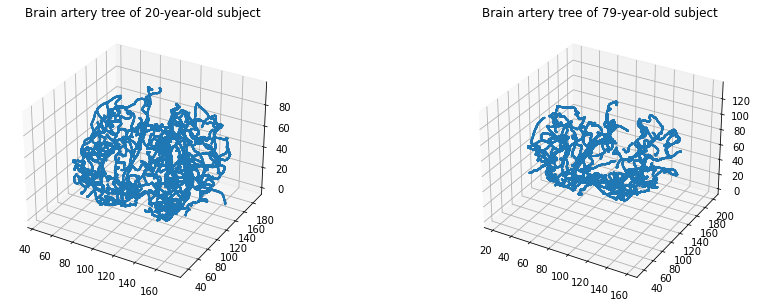

In [8]:
fig = plt.figure(figsize=(15,5))

# set up the axes for the first plot
coordinates_group0 = np.asarray(df_vis['vertices_coordinates'].iloc[0])
ax = fig.add_subplot(1, 2, 1, projection='3d')
ax.title.set_text('Brain artery tree of 20-year-old subject')
ax.scatter(coordinates_group0[:,0], coordinates_group0[:,1], coordinates_group0[:,2], 'ko', s=1)

# set up the axes for the second plot
coordinates_group1 = np.asarray(df_vis['vertices_coordinates'].iloc[1])
ax = fig.add_subplot(1, 2, 2, projection='3d')
ax.title.set_text('Brain artery tree of 79-year-old subject')
ax.scatter(coordinates_group1[:,0], coordinates_group1[:,1], coordinates_group1[:,2], 'ko', s=1)
plt.show()


In [9]:
plot_point_cloud(coordinates_group0)


/var/folders/f3/j1_w9czx27s731_0cjkjvshr0000gn/T/ipykernel_86429/2264777580.py:5: MatplotlibDeprecationWarning:

Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.



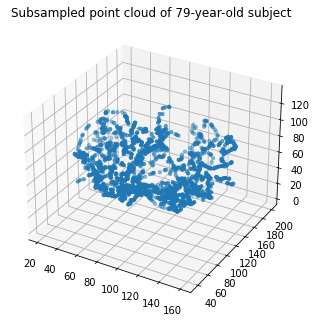

In [11]:
from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D

fig = pyplot.figure()
ax = Axes3D(fig)
example = np.asarray(df['subsampled_point_cloud_2000'].iloc[93])
ax.scatter(example[:,0], example[:,1], example[:,2], 'ko', s=10)
ax.title.set_text('Subsampled point cloud of 79-year-old subject')
pyplot.show()

In [12]:
plot_point_cloud(example)

In [13]:
# convert the pandas dataframe column into a 3D array for PH calculations
subsampled_point_cloud_500 = df['subsampled_point_cloud_2000'].to_list()
X_array = np.array(subsampled_point_cloud_500)

In [14]:
X_array.shape

(98, 2000, 3)

In [15]:
from gtda.homology import VietorisRipsPersistence
%time
homology_dimensions = [0,1]

persistence = VietorisRipsPersistence(
    metric="euclidean",
    homology_dimensions=homology_dimensions,
    n_jobs=6,
)
diagrams_basic = persistence.fit_transform(X_array)

CPU times: user 2 µs, sys: 1 µs, total: 3 µs
Wall time: 5.01 µs


In [16]:
plot_diagram(diagrams_basic[2])

In [17]:
plot_diagram(diagrams_basic[93])

In [18]:
from gtda.diagrams import PersistenceEntropy

persistence_entropy = PersistenceEntropy()

# calculate topological feature matrix
X_basic = persistence_entropy.fit_transform(diagrams_basic)

# expect shape - (n_point_clouds, n_homology_dims)
X_basic.shape

(98, 2)

In [19]:
plot_point_cloud(X_basic)

In [33]:
from sklearn.pipeline import make_union

# Use multiple metrics for calculating amplitudes
metrics = [
    {"metric": metric}
    for metric in ["bottleneck", "wasserstein", "landscape", "persistence_image", "heat", "silhouette"]
]


feature_union = make_union(
    PersistenceEntropy(normalize=True),
    NumberOfPoints(n_jobs=-1),
    *[Amplitude(**metric, n_jobs=-1) for metric in metrics]
)

In [28]:
pipe = Pipeline(
    [
        ("features", feature_union),
        ("rf", RandomForestClassifier(oob_score=True, random_state=42)),
    ]
)
pipe.fit(diagrams_basic, y2)
pipe["rf"].oob_score_

0.5102040816326531

In [36]:
pipe = Pipeline(
    [
        ("features", feature_union),
        ("rf", RandomForestClassifier(oob_score=True, random_state=42)),
    ]
)
pipe.fit(diagrams_basic, y)
pipe["rf"].oob_score_

0.7653061224489796

In [30]:
# train a baseline classifier with the total artery length, gender and hand attributes.
y = df['label'].to_list()
rf = RandomForestClassifier(oob_score=True, random_state=42)

df_ml = df[['total_artery_length', 'gender','hand']].copy()
rf.fit(df_ml, y)

print(f"OOB score: {rf.oob_score_:.3f}")

OOB score: 0.714


In [31]:
# train a baseline classifier with the total artery length, gender and hand attributes.
y = df['label'].to_list()
rf = RandomForestClassifier(oob_score=True, random_state=42)

df_ml = df[['total_artery_length', 'label','hand']].copy()
rf.fit(df_ml, y2)

print(f"OOB score: {rf.oob_score_:.3f}")

OOB score: 0.480
